In [4]:
import logging
from argparse import ArgumentParser
from multiprocessing import Pool
from pathlib import Path
from random import shuffle

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import tifffile
from laptrack import LapTrack
from skimage.measure import regionprops_table
from skimage.transform import downscale_local_mean
import itertools
from typing import Iterable, List, Any
from tqdm import tqdm

def chunker(iterable: Iterable[Any], size: int) -> Iterable[List[Any]]:
    """
    Batch data into lists of length n. The last batch may be shorter.
    """
    it = iter(iterable)
    while True:
        chunk = list(itertools.islice(it, size))
        if not chunk:
            break
        yield chunk

logging.basicConfig(level="INFO")



In [5]:


def run_cellpose(infile, args):
    from cellpose import models
    from cellpose.io import imread

    model = models.CellposeModel(gpu=True, pretrained_model=args.model)

    stack = imread(infile)

    stack = [frame.astype(np.uint16)[args.channel] for frame in stack]

    if len(args.cellpose_norm) == 2:
        normalize = {"lowhigh": [args.cellpose_norm[0], args.cellpose_norm[1]]}

    else:
        normalize = True

    all_masks = []

    for substack in tqdm(chunker(stack, 2)):
        height = substack[0].shape[0]
        long_img = np.concatenate(substack, axis=0)

        masks, _flows, _styles = model.eval(long_img, batch_size=64, normalize=normalize)

        for i in range(0, masks.shape[0], height):
            this_masks = masks[i:i+height]
            all_masks.append(this_masks)

    masks = np.stack(all_masks, axis=0)

    return masks


def process_masks(masks):
    collect_spots = []

    for t, frame in enumerate(masks):
        props = regionprops_table(frame, properties=["label", "area", "centroid"])

        df = pd.DataFrame(props)
        df["frame"] = t
        df = df.rename(columns={"centroid-0": "px_y", "centroid-1": "px_x"})

        print(df)

        collect_spots.append(df)

    spots_df = pd.concat([s for s in collect_spots], ignore_index=True)

    return spots_df


def track_spots(spots_df):
    max_distance = 20

    lt = LapTrack(
        metric="sqeuclidean",
        # The similarity metric for particles. See `scipy.spatial.distance.cdist` for allowed values.
        splitting_metric="sqeuclidean",
        merging_metric="sqeuclidean",
        gap_closing_metric="sqeuclidean",
        # the square of the cutoff distance for the "sqeuclidean" metric
        cutoff=max_distance**2,
        splitting_cutoff=False,  # or False for non-splitting case
        merging_cutoff=False,  # or False for non-merging case
        gap_closing_cutoff=max_distance**2,
        gap_closing_max_frame_count=2,
    )

    track_df, _split_df, _merge_df = lt.predict_dataframe(
        spots_df,
        coordinate_cols=[
            "px_x",
            "px_y",
        ],  # the column names for the coordinates
        frame_col="frame",  # the column name for the frame (default "frame")
        only_coordinate_cols=False,
    )

    track_df = track_df.rename(columns={"frame_y": "frame"})

    return track_df

def process_file(infile, in_dir, args):
    masks_dir = in_dir / "masks"
    tracks_dir = in_dir / "tracks"

    masks_outfile = masks_dir / f"{infile.stem}_masks.tif"
    tracks_outfile = tracks_dir / f"{infile.stem}_tracks.csv"

    print(masks_outfile)

    if masks_outfile.exists():
        cellpose_masks = tifffile.imread(masks_outfile)
        print(f"{masks_outfile.stem} exists: loading data")

    else:
        cellpose_masks = run_cellpose(str(infile), args)
        tifffile.imwrite(
            masks_outfile,
            cellpose_masks.astype(np.uint16),
            imagej=True,
            metadata={"axes": "tyx"},
        )

    if tracks_outfile.exists():
        tracks = pd.read_csv(tracks_outfile)
        print(f"{tracks_outfile.stem} exists: loading data")

    else:
        spots = process_masks(cellpose_masks)

        tracks = track_spots(spots)
        tracks.to_csv(tracks_outfile, index=False)

    return tracks

In [7]:
from types import SimpleNamespace

args = SimpleNamespace(
    dir = r"D:\Harrison\cells\mdck_analysis\barspeeds",  # the folder containing the tifs
    glob = "*.tif",  # segments all the .tif files in a directory
    cellpose_norm = [0, 6000], # lowest and highest pixel intensities
    model = "mdck_optoegfr_01",  # name of the cellpose model to load
    channel = 0,
)

segmenting and tracking file 0/37: bar025.10k2.02_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar025.10k2.02_channel_545_patterns_masks.tif


INFO:cellpose.core:** TORCH CUDA version installed and working. **
INFO:cellpose.core:>>>> using GPU (CUDA)
INFO:cellpose.models:>>>> loading model C:\Users\Nikon\.cellpose\models\mdck_optoegfr_01
INFO:cellpose.io:reading tiff with 576 planes
100%|██████████| 576/576 [00:00<00:00, 1114.94it/s]
0it [00:00, ?it/s]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
1it [00:05,  5.38s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
2it [00:09,  4.60s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
3it [00:13,  4.34s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
4it [00:17,  4.20s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
5it [00:21,  4.12s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
6it [00:25,  4.08s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
7it [00:29,  4.02s/it]INFO:cellpose.transforms:proc

      label   area        px_y        px_x  frame
0         1  149.0    6.268456  149.107383      0
1         2  125.0    6.048000  166.488000      0
2         3  173.0    8.612717  112.803468      0
3         4  146.0    7.945205  556.500000      0
4         5  132.0   10.909091  190.787879      0
...     ...    ...         ...         ...    ...
2006   2007  122.0  751.172131  503.631148      0
2007   2008  170.0  753.152941  673.605882      0
2008   2009   99.0  754.373737  157.040404      0
2009   2010  125.0  755.056000  532.944000      0
2010   2011  160.0  756.118750  707.987500      0

[2011 rows x 5 columns]
      label   area        px_y        px_x  frame
0      2012  168.0    6.142857  148.059524      1
1      2013  104.0    5.557692  165.740385      1
2      2014  205.0    8.624390  113.785366      1
3      2015  348.0   12.008621  519.537356      1
4      2016  185.0    9.816216  575.340541      1
...     ...    ...         ...         ...    ...
1962   3974  145.0  751.0

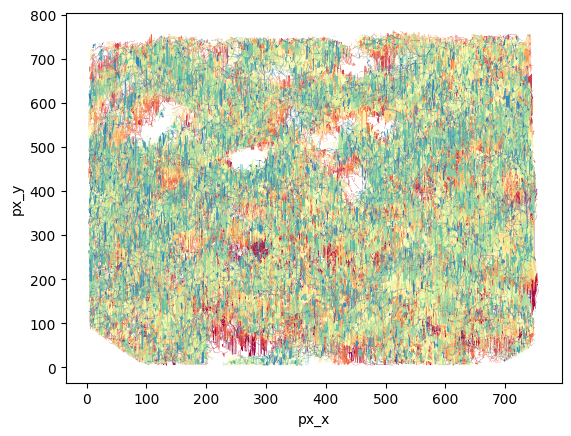

INFO:cellpose.core:** TORCH CUDA version installed and working. **
INFO:cellpose.core:>>>> using GPU (CUDA)


segmenting and tracking file 1/37: bar025.10k2.03_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar025.10k2.03_channel_545_patterns_masks.tif


INFO:cellpose.models:>>>> loading model C:\Users\Nikon\.cellpose\models\mdck_optoegfr_01
INFO:cellpose.io:reading tiff with 576 planes
100%|██████████| 576/576 [00:00<00:00, 1057.77it/s]
0it [00:00, ?it/s]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
1it [00:03,  3.84s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
2it [00:07,  3.92s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
3it [00:11,  3.81s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
4it [00:15,  3.74s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
5it [00:18,  3.73s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
6it [00:22,  3.72s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
7it [00:26,  3.74s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
8it [00:30,  4.00s/it]INFO:cellpose.transforms:processing graysca

      label   area        px_y        px_x  frame
0         1  193.0    6.694301  390.020725      0
1         2  105.0    5.076190  158.457143      0
2         3  234.0    8.341880  172.705128      0
3         4  233.0    9.682403  143.278970      0
4         5  309.0   12.294498  403.268608      0
...     ...    ...         ...         ...    ...
1767   1768  226.0  751.323009  610.163717      0
1768   1769  387.0  752.568475  651.736434      0
1769   1770  194.0  755.618557  696.829897      0
1770   1771  239.0  754.401674  499.878661      0
1771   1772  306.0  754.287582  520.516340      0

[1772 rows x 5 columns]
      label   area        px_y        px_x  frame
0      1773  107.0    5.177570  157.084112      1
1      1774  190.0    7.089474  389.978947      1
2      1775  202.0   10.044554  142.460396      1
3      1776  233.0    8.618026  171.862661      1
4      1777  320.0   12.590625  403.068750      1
...     ...    ...         ...         ...    ...
1750   3523  131.0  752.1

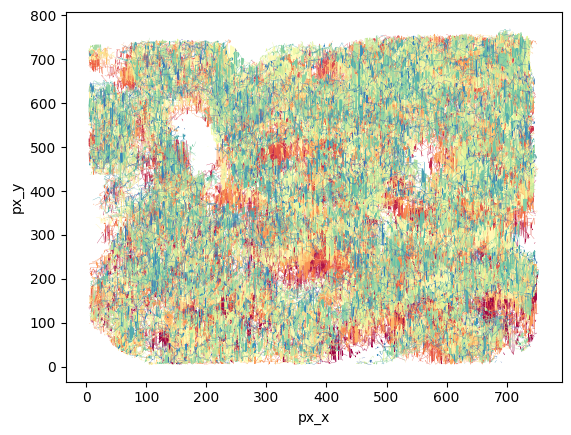

INFO:cellpose.core:** TORCH CUDA version installed and working. **
INFO:cellpose.core:>>>> using GPU (CUDA)


segmenting and tracking file 2/37: bar025.20k.00_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar025.20k.00_channel_545_patterns_masks.tif


INFO:cellpose.models:>>>> loading model C:\Users\Nikon\.cellpose\models\mdck_optoegfr_01
INFO:cellpose.io:reading tiff with 542 planes
100%|██████████| 542/542 [00:00<00:00, 719.80it/s]
0it [00:00, ?it/s]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
1it [00:04,  4.77s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
2it [00:08,  4.33s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
3it [00:12,  4.19s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
4it [00:16,  4.13s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
5it [00:20,  4.10s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
6it [00:24,  4.09s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
7it [00:28,  4.05s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
8it [00:32,  4.05s/it]INFO:cellpose.transforms:processing grayscal

      label   area        px_y        px_x  frame
0         1  283.0    8.000000  235.215548      0
1         2  227.0    7.977974  520.872247      0
2         3  326.0   14.739264  217.190184      0
3         4  223.0    9.385650  603.475336      0
4         5  191.0   10.685864  535.890052      0
...     ...    ...         ...         ...    ...
2102   2103  179.0  750.664804  632.201117      0
2103   2104  171.0  751.333333  649.011696      0
2104   2105  148.0  750.648649  507.689189      0
2105   2106  157.0  752.414013  494.560510      0
2106   2107  164.0  754.676829  661.792683      0

[2107 rows x 5 columns]
      label   area        px_y        px_x  frame
0      2108   98.0    5.326531  255.571429      1
1      2109  208.0    8.076923  523.033654      1
2      2110  291.0    8.934708  606.591065      1
3      2111  100.0    5.730000  661.120000      1
4      2112  211.0    9.222749  238.454976      1
...     ...    ...         ...         ...    ...
2048   4156  101.0  748.2

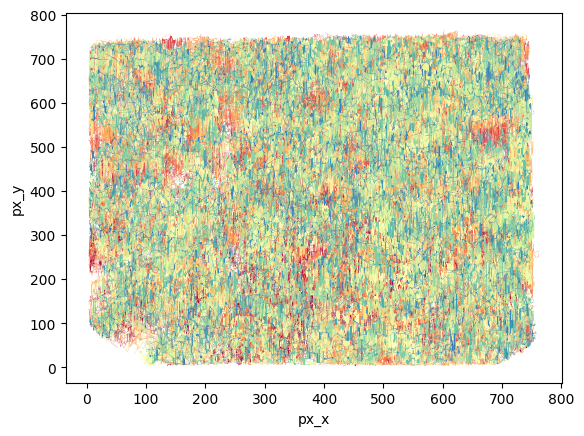

INFO:cellpose.core:** TORCH CUDA version installed and working. **
INFO:cellpose.core:>>>> using GPU (CUDA)


segmenting and tracking file 3/37: bar025.20k.01_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar025.20k.01_channel_545_patterns_masks.tif


INFO:cellpose.models:>>>> loading model C:\Users\Nikon\.cellpose\models\mdck_optoegfr_01
INFO:cellpose.io:reading tiff with 542 planes
100%|██████████| 542/542 [00:00<00:00, 739.39it/s]
0it [00:00, ?it/s]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
1it [00:04,  4.16s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
2it [00:08,  4.00s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
3it [00:11,  3.98s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
4it [00:16,  4.28s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
5it [00:20,  4.16s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
6it [00:24,  4.06s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
7it [00:28,  3.97s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
8it [00:32,  3.93s/it]INFO:cellpose.transforms:processing grayscal

      label   area        px_y        px_x  frame
0         1  153.0    5.019608  309.339869      0
1         2  124.0    6.185484  153.991935      0
2         3  210.0    9.185714  228.566667      0
3         4  304.0   10.345395  244.601974      0
4         5  101.0    5.722772  289.188119      0
...     ...    ...         ...         ...    ...
1947   1948  219.0  746.392694  689.237443      0
1948   1949  147.0  749.462585  399.993197      0
1949   1950  143.0  750.860140  614.972028      0
1950   1951  262.0  755.958015  636.500000      0
1951   1952  160.0  754.306250  415.162500      0

[1952 rows x 5 columns]
      label   area        px_y        px_x  frame
0      1953  136.0    7.801471  114.308824      1
1      1954  291.0   11.371134  244.628866      1
2      1955  201.0    8.119403  262.124378      1
3      1956  138.0    5.246377  307.485507      1
4      1957  186.0    9.413978  320.870968      1
...     ...    ...         ...         ...    ...
1964   3917  196.0  749.6

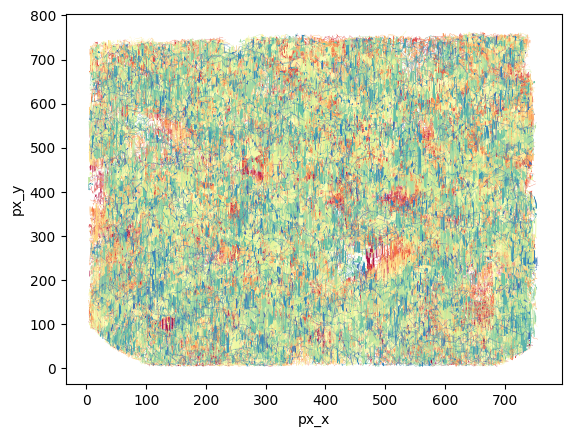

INFO:cellpose.core:** TORCH CUDA version installed and working. **
INFO:cellpose.core:>>>> using GPU (CUDA)


segmenting and tracking file 4/37: bar05.10k2.02_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar05.10k2.02_channel_545_patterns_masks.tif


INFO:cellpose.models:>>>> loading model C:\Users\Nikon\.cellpose\models\mdck_optoegfr_01
INFO:cellpose.io:reading tiff with 576 planes
100%|██████████| 576/576 [00:00<00:00, 1117.10it/s]
0it [00:00, ?it/s]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
1it [00:04,  4.16s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
2it [00:08,  4.17s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
3it [00:12,  4.10s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
4it [00:16,  4.02s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
5it [00:20,  3.99s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
6it [00:24,  4.03s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
7it [00:28,  4.01s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
8it [00:32,  4.05s/it]INFO:cellpose.transforms:processing graysca

      label   area        px_y        px_x  frame
0         1  196.0    6.816327  199.000000      0
1         2  272.0    8.915441  236.187500      0
2         3  372.0    7.868280  455.629032      0
3         4  309.0    9.304207  643.113269      0
4         5  286.0   10.304196  658.632867      0
...     ...    ...         ...         ...    ...
1758   1759  337.0  749.059347  597.029674      0
1759   1760  181.0  749.408840  693.734807      0
1760   1761  220.0  748.545455  706.881818      0
1761   1762  175.0  755.348571  492.811429      0
1762   1763  223.0  755.286996  636.071749      0

[1763 rows x 5 columns]
      label   area        px_y        px_x  frame
0      1764  225.0    8.093333  199.555556      1
1      1765  256.0    8.394531  236.144531      1
2      1766  253.0    6.869565  619.968379      1
3      1767  333.0   10.375375  644.810811      1
4      1768  269.0    9.739777  660.022305      1
...     ...    ...         ...         ...    ...
1692   3456  347.0  748.7

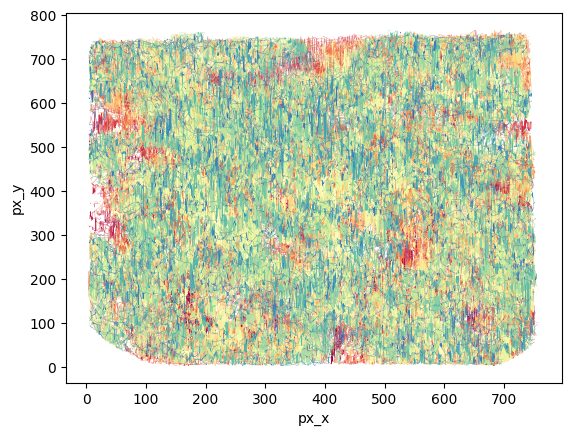

INFO:cellpose.core:** TORCH CUDA version installed and working. **
INFO:cellpose.core:>>>> using GPU (CUDA)


segmenting and tracking file 5/37: bar05.10k2.03_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar05.10k2.03_channel_545_patterns_masks.tif


INFO:cellpose.models:>>>> loading model C:\Users\Nikon\.cellpose\models\mdck_optoegfr_01
INFO:cellpose.io:reading tiff with 576 planes
100%|██████████| 576/576 [00:00<00:00, 1155.08it/s]
0it [00:00, ?it/s]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
1it [00:03,  3.57s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
2it [00:07,  3.56s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
3it [00:10,  3.57s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
4it [00:14,  3.58s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
5it [00:17,  3.57s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
6it [00:21,  3.56s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
7it [00:24,  3.54s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
8it [00:28,  3.53s/it]INFO:cellpose.transforms:processing graysca

      label   area        px_y        px_x  frame
0         1  243.0   12.572016  514.753086      0
1         2  151.0   11.655629  136.516556      0
2         3  148.0   11.858108  491.432432      0
3         4  320.0   17.596875  152.790625      0
4         5  320.0   17.350000  476.371875      0
...     ...    ...         ...         ...    ...
1457   1458  175.0  750.805714  538.085714      0
1458   1459   99.0  752.828283  490.101010      0
1459   1460  157.0  755.872611  443.121019      0
1460   1461  221.0  756.203620  673.570136      0
1461   1462  132.0  759.007576  647.643939      0

[1462 rows x 5 columns]
      label   area        px_y        px_x  frame
0      1463  286.0   11.461538  135.381119      1
1      1464  586.0   15.310580  157.959044      1
2      1465  155.0   17.858065  180.722581      1
3      1466  292.0   20.962329  374.777397      1
4      1467  731.0   28.430917  490.511628      1
...     ...    ...         ...         ...    ...
1463   2926  214.0  750.2

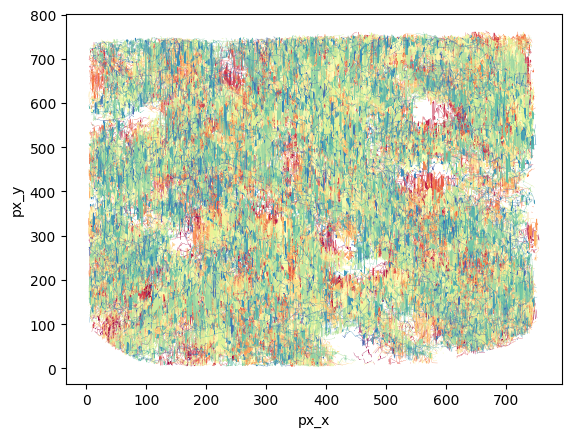

INFO:cellpose.core:** TORCH CUDA version installed and working. **
INFO:cellpose.core:>>>> using GPU (CUDA)


segmenting and tracking file 6/37: bar05.20k.00_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar05.20k.00_channel_545_patterns_masks.tif


INFO:cellpose.models:>>>> loading model C:\Users\Nikon\.cellpose\models\mdck_optoegfr_01
INFO:cellpose.io:reading tiff with 542 planes
100%|██████████| 542/542 [00:00<00:00, 732.41it/s]
0it [00:00, ?it/s]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
1it [00:03,  3.98s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
2it [00:07,  3.92s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
3it [00:11,  3.88s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
4it [00:15,  3.87s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
5it [00:19,  3.87s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
6it [00:24,  4.15s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
7it [00:27,  4.03s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
8it [00:31,  3.96s/it]INFO:cellpose.transforms:processing grayscal

      label   area        px_y        px_x  frame
0         1  130.0    5.023077  165.930769      0
1         2  147.0    5.891156  413.918367      0
2         3  413.0    8.503632  130.443099      0
3         4  123.0    5.577236  183.495935      0
4         5  245.0    9.424490  197.342857      0
...     ...    ...         ...         ...    ...
1996   1997  155.0  748.845161  551.800000      0
1997   1998  188.0  750.276596  696.143617      0
1998   1999  189.0  753.153439  403.037037      0
1999   2000  135.0  752.859259  416.074074      0
2000   2001  127.0  753.858268  493.417323      0

[2001 rows x 5 columns]
      label   area        px_y        px_x  frame
0      2002  395.0    8.483544  131.546835      1
1      2003  137.0    5.525547  166.656934      1
2      2004  140.0    5.792857  184.221429      1
3      2005  218.0    7.463303  216.215596      1
4      2006  140.0    5.985714  260.807143      1
...     ...    ...         ...         ...    ...
1955   3957  120.0  750.4

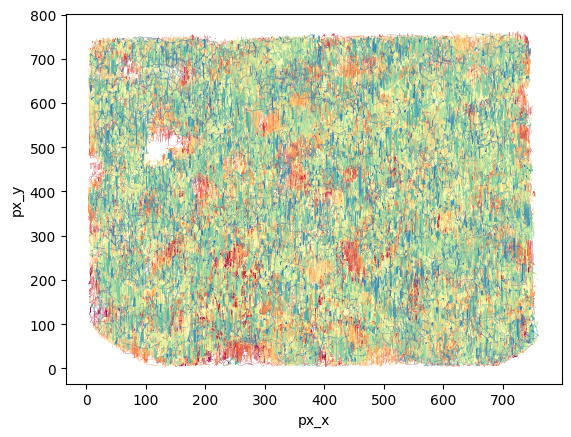

INFO:cellpose.core:** TORCH CUDA version installed and working. **
INFO:cellpose.core:>>>> using GPU (CUDA)


segmenting and tracking file 7/37: bar05.20k.01_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar05.20k.01_channel_545_patterns_masks.tif


INFO:cellpose.models:>>>> loading model C:\Users\Nikon\.cellpose\models\mdck_optoegfr_01
INFO:cellpose.io:reading tiff with 542 planes
100%|██████████| 542/542 [00:00<00:00, 742.42it/s]
0it [00:00, ?it/s]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
1it [00:04,  4.30s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
2it [00:08,  4.19s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
3it [00:13,  4.52s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
4it [00:17,  4.36s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
5it [00:21,  4.28s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
6it [00:25,  4.21s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
7it [00:29,  4.22s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
8it [00:34,  4.20s/it]INFO:cellpose.transforms:processing grayscal

      label   area        px_y        px_x  frame
0         1  196.0    8.086735  463.801020      0
1         2  196.0    8.663265  128.974490      0
2         3  225.0    9.804444  565.884444      0
3         4  105.0    6.152381  114.933333      0
4         5   91.0    6.450549  202.000000      0
...     ...    ...         ...         ...    ...
2243   2244  138.0  752.398551  729.253623      0
2244   2245  117.0  756.888889  545.128205      0
2245   2246  170.0  762.988235  649.494118      0
2246   2247  106.0  761.679245  673.584906      0
2247   2248  112.0  763.428571  662.741071      0

[2248 rows x 5 columns]
      label   area        px_y        px_x  frame
0      2249  179.0    7.547486  129.173184      1
1      2250  162.0    7.672840  465.049383      1
2      2251  165.0    7.836364  568.212121      1
3      2252   75.0    5.960000  114.733333      1
4      2253  232.0   10.310345  581.219828      1
...     ...    ...         ...         ...    ...
2262   4511  135.0  753.4

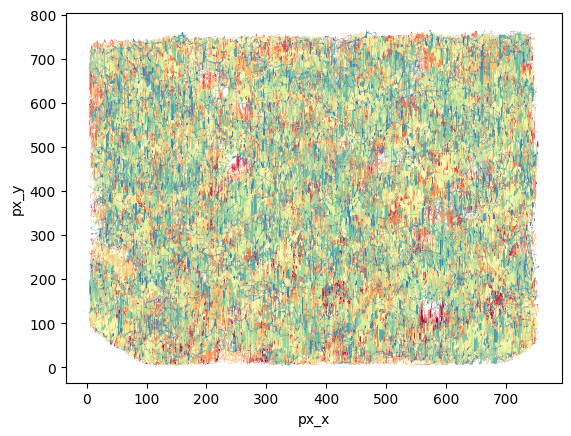

INFO:cellpose.core:** TORCH CUDA version installed and working. **
INFO:cellpose.core:>>>> using GPU (CUDA)


segmenting and tracking file 8/37: bar075.10k2.02_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar075.10k2.02_channel_545_patterns_masks.tif


INFO:cellpose.models:>>>> loading model C:\Users\Nikon\.cellpose\models\mdck_optoegfr_01
INFO:cellpose.io:reading tiff with 576 planes
100%|██████████| 576/576 [00:00<00:00, 1152.78it/s]
0it [00:00, ?it/s]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
1it [00:03,  3.84s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
2it [00:07,  3.80s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
3it [00:11,  3.79s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
4it [00:15,  3.78s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
5it [00:18,  3.79s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
6it [00:22,  3.82s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
7it [00:26,  3.81s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
8it [00:30,  3.80s/it]INFO:cellpose.transforms:processing graysca

      label   area        px_y        px_x  frame
0         1  111.0    5.171171  383.936937      0
1         2   96.0    4.885417  397.416667      0
2         3  229.0    7.248908  215.799127      0
3         4  210.0    7.642857  340.428571      0
4         5  110.0    4.427273  371.790909      0
...     ...    ...         ...         ...    ...
1884   1885  218.0  750.417431  316.935780      0
1885   1886  177.0  749.892655  336.525424      0
1886   1887  182.0  751.384615  710.307692      0
1887   1888  176.0  753.659091  548.630682      0
1888   1889  106.0  760.518868  723.481132      0

[1889 rows x 5 columns]
      label   area        px_y        px_x  frame
0      1890  161.0    7.130435  189.049689      1
1      1891  217.0    7.626728  214.313364      1
2      1892   86.0    5.116279  383.069767      1
3      1893   79.0    4.506329  396.481013      1
4      1894  118.0    5.449153  409.661017      1
...     ...    ...         ...         ...    ...
1815   3705  328.0  749.2

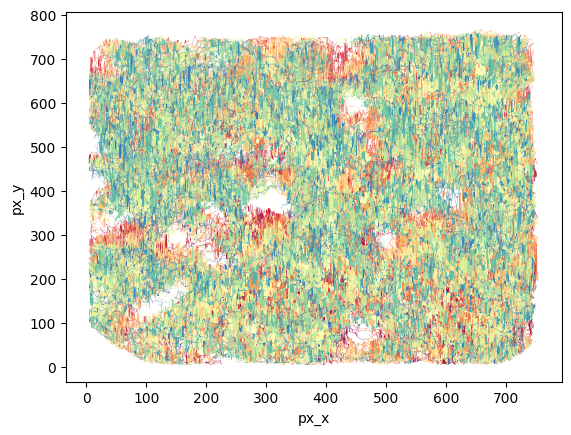

INFO:cellpose.core:** TORCH CUDA version installed and working. **
INFO:cellpose.core:>>>> using GPU (CUDA)


segmenting and tracking file 9/37: bar075.10k2.03_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar075.10k2.03_channel_545_patterns_masks.tif


INFO:cellpose.models:>>>> loading model C:\Users\Nikon\.cellpose\models\mdck_optoegfr_01
INFO:cellpose.io:reading tiff with 576 planes
100%|██████████| 576/576 [00:00<00:00, 1155.08it/s]
0it [00:00, ?it/s]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
1it [00:03,  3.84s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
2it [00:07,  3.77s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
3it [00:11,  3.72s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
4it [00:14,  3.72s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
5it [00:18,  3.71s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
6it [00:22,  3.72s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
7it [00:26,  3.70s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
8it [00:29,  3.70s/it]INFO:cellpose.transforms:processing graysca

      label   area        px_y        px_x  frame
0         1  281.0    6.793594  581.270463      0
1         2  150.0    7.080000  260.340000      0
2         3  139.0    6.129496  410.956835      0
3         4  199.0    7.618090  427.145729      0
4         5  139.0    6.856115  512.892086      0
...     ...    ...         ...         ...    ...
1809   1810  158.0  754.462025  485.645570      0
1810   1811  220.0  756.872727  615.077273      0
1811   1812  241.0  758.091286  655.037344      0
1812   1813  162.0  759.080247  673.067901      0
1813   1814  153.0  760.986928  636.836601      0

[1814 rows x 5 columns]
      label   area        px_y        px_x  frame
0      1815   97.0    4.659794  396.432990      1
1      1816  156.0    5.955128  410.121795      1
2      1817  192.0    7.354167  426.661458      1
3      1818  242.0   10.123967  559.586777      1
4      1819  285.0    7.656140  584.154386      1
...     ...    ...         ...         ...    ...
1797   3612  199.0  753.8

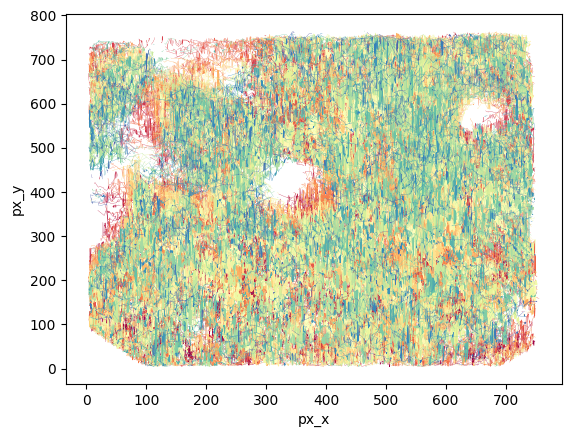

INFO:cellpose.core:** TORCH CUDA version installed and working. **
INFO:cellpose.core:>>>> using GPU (CUDA)


segmenting and tracking file 10/37: bar075.20k.00_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar075.20k.00_channel_545_patterns_masks.tif


INFO:cellpose.models:>>>> loading model C:\Users\Nikon\.cellpose\models\mdck_optoegfr_01
INFO:cellpose.io:reading tiff with 542 planes
100%|██████████| 542/542 [00:00<00:00, 743.43it/s]
0it [00:00, ?it/s]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
1it [00:03,  3.85s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
2it [00:07,  3.80s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
3it [00:11,  3.78s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
4it [00:15,  3.74s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
5it [00:18,  3.75s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
6it [00:22,  3.72s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
7it [00:26,  3.74s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
8it [00:30,  3.74s/it]INFO:cellpose.transforms:processing grayscal

      label   area        px_y        px_x  frame
0         1  219.0    9.849315  136.205479      0
1         2  218.0    9.926606  271.954128      0
2         3  163.0    7.116564  313.000000      0
3         4  121.0    5.595041  358.628099      0
4         5  168.0   10.279762  125.976190      0
...     ...    ...         ...         ...    ...
1857   1858  299.0  754.896321  726.698997      0
1858   1859  136.0  750.566176  529.058824      0
1859   1860  248.0  755.770161  704.495968      0
1860   1861  186.0  762.967742  694.430108      0
1861   1862  170.0  764.835294  715.870588      0

[1862 rows x 5 columns]
      label   area        px_y        px_x  frame
0      1863  197.0   10.050761  125.685279      1
1      1864  187.0    8.641711  273.090909      1
2      1865  165.0    6.636364  315.478788      1
3      1866  125.0    4.960000  360.200000      1
4      1867  143.0    6.839161  669.972028      1
...     ...    ...         ...         ...    ...
1859   3722  189.0  752.9

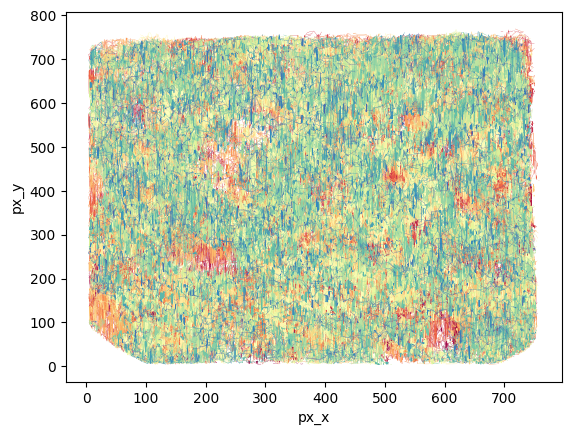

INFO:cellpose.core:** TORCH CUDA version installed and working. **
INFO:cellpose.core:>>>> using GPU (CUDA)


segmenting and tracking file 11/37: bar075.20k.01_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar075.20k.01_channel_545_patterns_masks.tif


INFO:cellpose.models:>>>> loading model C:\Users\Nikon\.cellpose\models\mdck_optoegfr_01
INFO:cellpose.io:reading tiff with 542 planes
100%|██████████| 542/542 [00:00<00:00, 736.38it/s]
0it [00:00, ?it/s]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
1it [00:03,  3.95s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
2it [00:07,  3.98s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
3it [00:11,  3.90s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
4it [00:15,  3.87s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
5it [00:19,  3.84s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
6it [00:23,  3.84s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
7it [00:27,  3.83s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
8it [00:31,  4.08s/it]INFO:cellpose.transforms:processing grayscal

      label   area        px_y        px_x  frame
0         1  160.0    5.850000  397.468750      0
1         2  127.0    5.740157  183.992126      0
2         3  307.0    9.602606  271.801303      0
3         4  112.0    7.294643  335.883929      0
4         5   88.0    5.102273  345.568182      0
...     ...    ...         ...         ...    ...
1882   1883  418.0  753.258373  665.964115      0
1883   1884  407.0  755.877150  632.194103      0
1884   1885  172.0  752.773256  681.552326      0
1885   1886  154.0  752.837662  709.396104      0
1886   1887  266.0  761.432331  613.988722      0

[1887 rows x 5 columns]
      label   area        px_y        px_x  frame
0      1888  159.0    5.748428  400.817610      1
1      1889  124.0    5.758065  183.814516      1
2      1890  122.0    7.016393  338.303279      1
3      1891  117.0    4.632479  431.341880      1
4      1892  128.0    6.710938  654.992188      1
...     ...    ...         ...         ...    ...
1901   3789  492.0  753.9

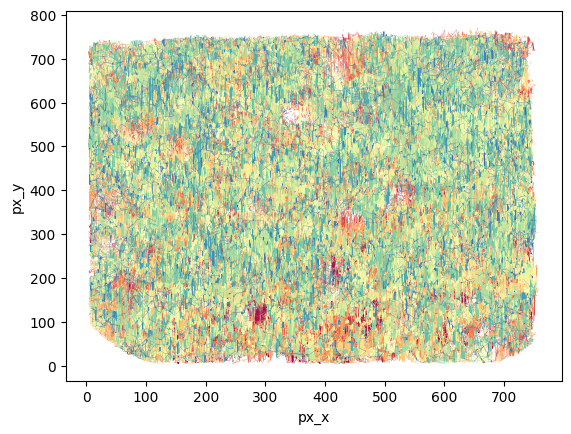

segmenting and tracking file 12/37: bar10.10k.00_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar10.10k.00_channel_545_patterns_masks.tif
bar10.10k.00_channel_545_patterns_masks exists: loading data
bar10.10k.00_channel_545_patterns_tracks exists: loading data


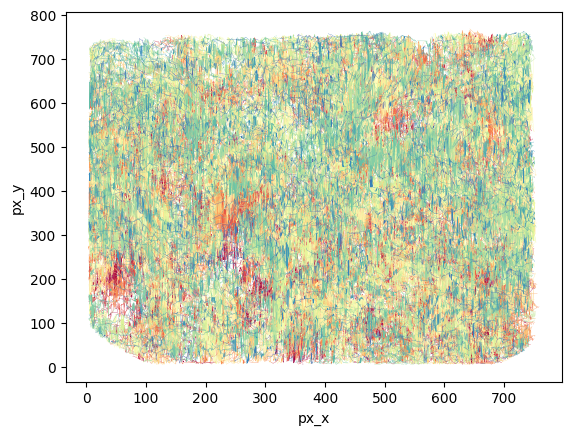

segmenting and tracking file 13/37: bar10.20k.01_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar10.20k.01_channel_545_patterns_masks.tif
bar10.20k.01_channel_545_patterns_masks exists: loading data
bar10.20k.01_channel_545_patterns_tracks exists: loading data


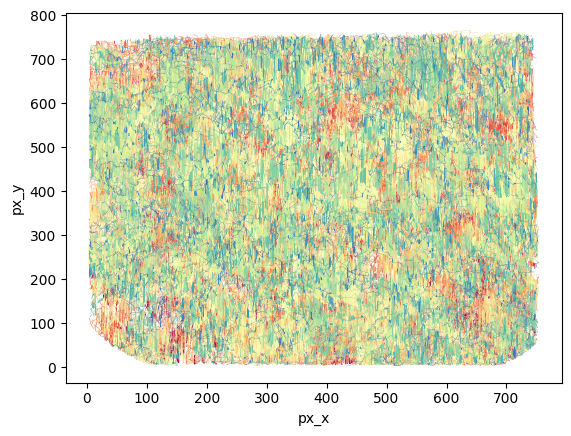

segmenting and tracking file 14/37: bar10.20k2.02_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar10.20k2.02_channel_545_patterns_masks.tif
bar10.20k2.02_channel_545_patterns_masks exists: loading data
bar10.20k2.02_channel_545_patterns_tracks exists: loading data


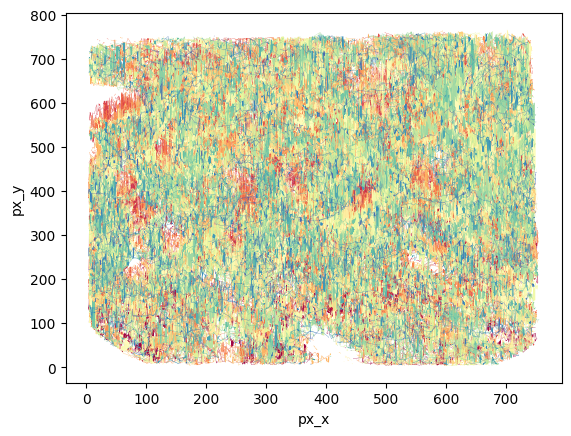

segmenting and tracking file 15/37: bar10.20k2.03_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar10.20k2.03_channel_545_patterns_masks.tif
bar10.20k2.03_channel_545_patterns_masks exists: loading data
bar10.20k2.03_channel_545_patterns_tracks exists: loading data


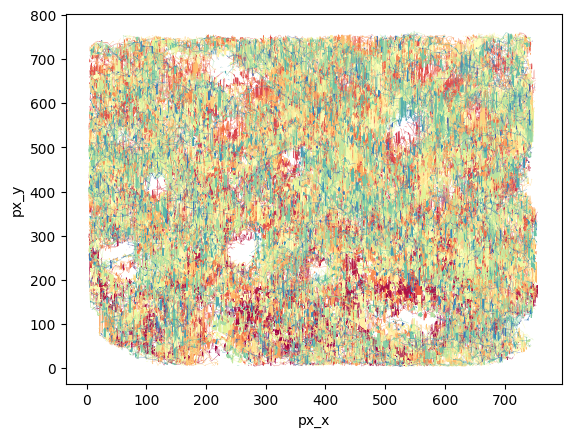

segmenting and tracking file 16/37: bar125.10k.00_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar125.10k.00_channel_545_patterns_masks.tif
bar125.10k.00_channel_545_patterns_masks exists: loading data
bar125.10k.00_channel_545_patterns_tracks exists: loading data


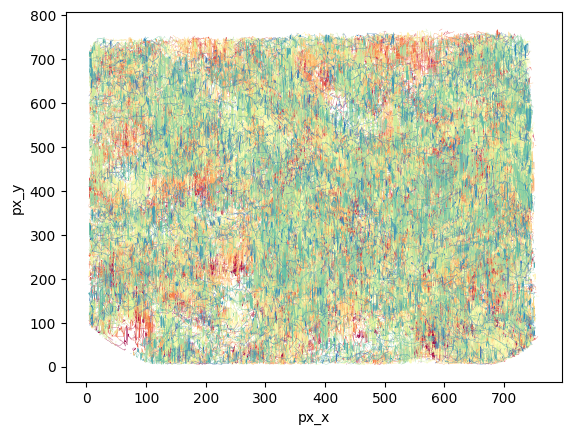

segmenting and tracking file 17/37: bar125.20k.01_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar125.20k.01_channel_545_patterns_masks.tif
bar125.20k.01_channel_545_patterns_masks exists: loading data
bar125.20k.01_channel_545_patterns_tracks exists: loading data


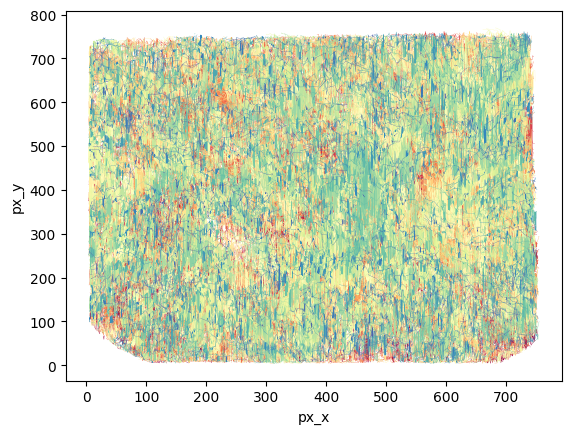

segmenting and tracking file 18/37: bar125.20k2.02_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar125.20k2.02_channel_545_patterns_masks.tif
bar125.20k2.02_channel_545_patterns_masks exists: loading data
bar125.20k2.02_channel_545_patterns_tracks exists: loading data


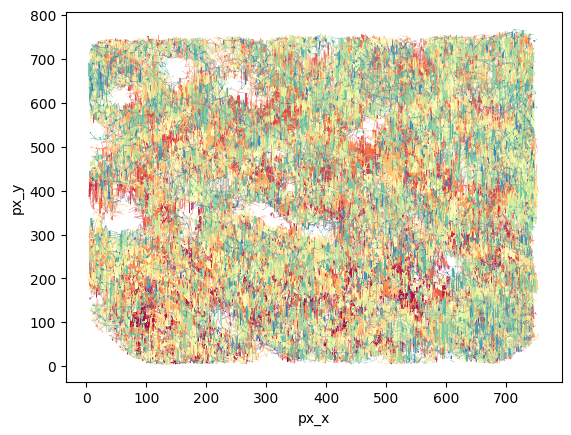

segmenting and tracking file 19/37: bar125.20k2.03_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar125.20k2.03_channel_545_patterns_masks.tif
bar125.20k2.03_channel_545_patterns_masks exists: loading data
bar125.20k2.03_channel_545_patterns_tracks exists: loading data


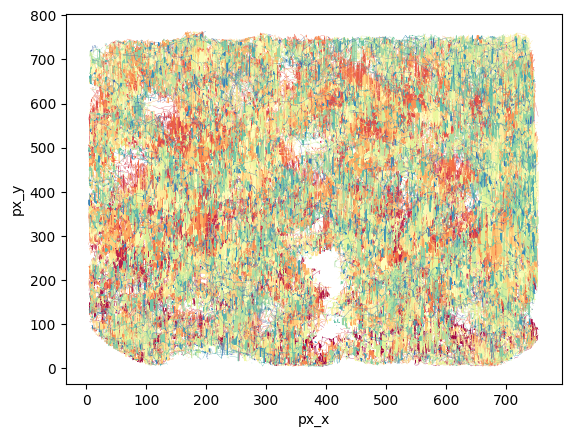

segmenting and tracking file 20/37: bar15.10k.00_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar15.10k.00_channel_545_patterns_masks.tif
bar15.10k.00_channel_545_patterns_masks exists: loading data
bar15.10k.00_channel_545_patterns_tracks exists: loading data


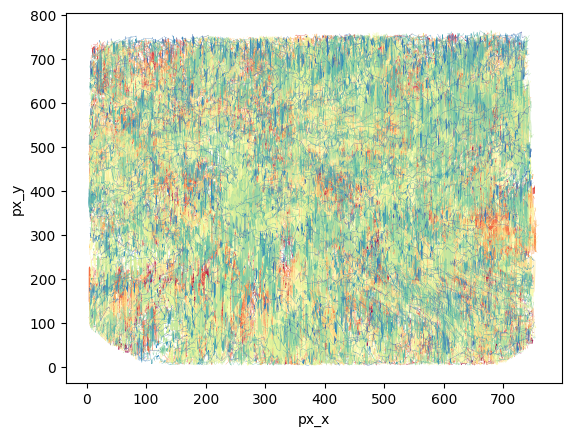

segmenting and tracking file 21/37: bar15.20k.01_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar15.20k.01_channel_545_patterns_masks.tif
bar15.20k.01_channel_545_patterns_masks exists: loading data
bar15.20k.01_channel_545_patterns_tracks exists: loading data


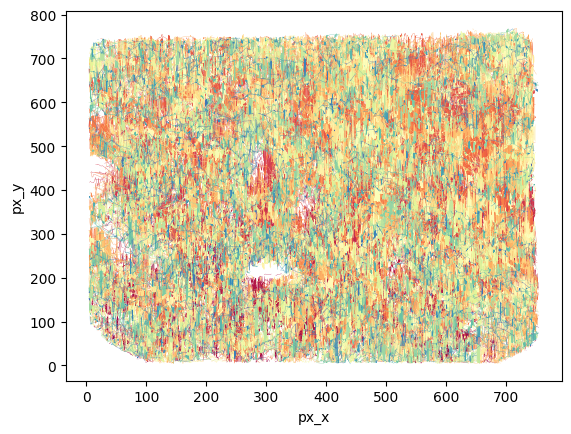

segmenting and tracking file 22/37: bar15.20k2.02_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar15.20k2.02_channel_545_patterns_masks.tif
bar15.20k2.02_channel_545_patterns_masks exists: loading data
bar15.20k2.02_channel_545_patterns_tracks exists: loading data


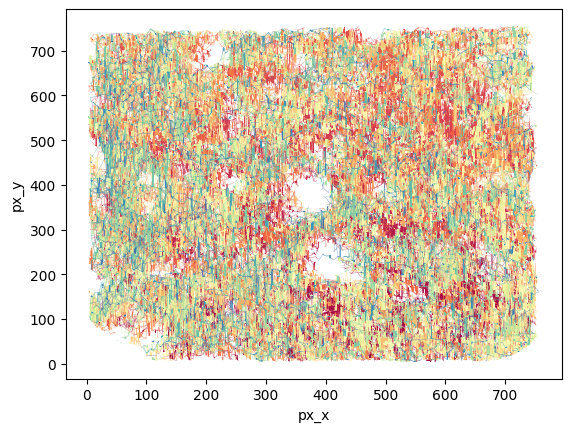

segmenting and tracking file 23/37: bar15.20k2.03_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar15.20k2.03_channel_545_patterns_masks.tif
bar15.20k2.03_channel_545_patterns_masks exists: loading data
bar15.20k2.03_channel_545_patterns_tracks exists: loading data


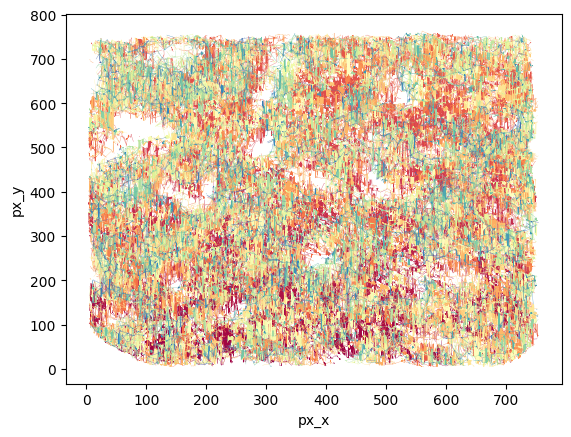

segmenting and tracking file 24/37: bar175.10k.00_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar175.10k.00_channel_545_patterns_masks.tif
bar175.10k.00_channel_545_patterns_masks exists: loading data
bar175.10k.00_channel_545_patterns_tracks exists: loading data


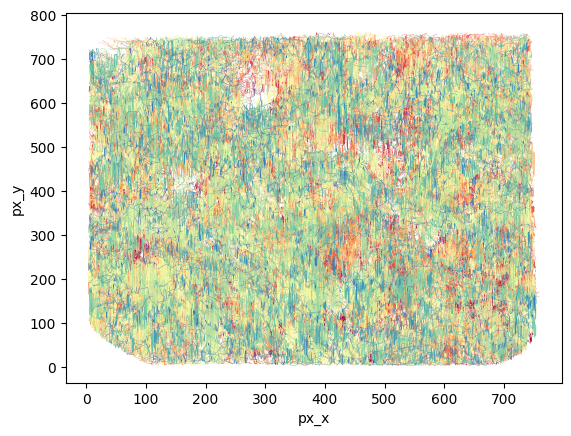

segmenting and tracking file 25/37: bar175.20k.01_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar175.20k.01_channel_545_patterns_masks.tif
bar175.20k.01_channel_545_patterns_masks exists: loading data
bar175.20k.01_channel_545_patterns_tracks exists: loading data


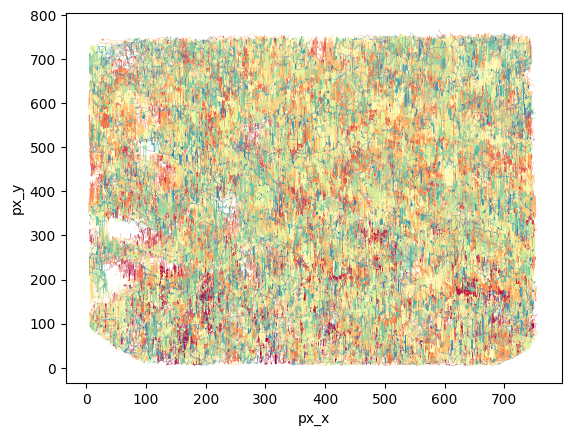

segmenting and tracking file 26/37: bar175.20k2.02_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar175.20k2.02_channel_545_patterns_masks.tif
bar175.20k2.02_channel_545_patterns_masks exists: loading data
bar175.20k2.02_channel_545_patterns_tracks exists: loading data


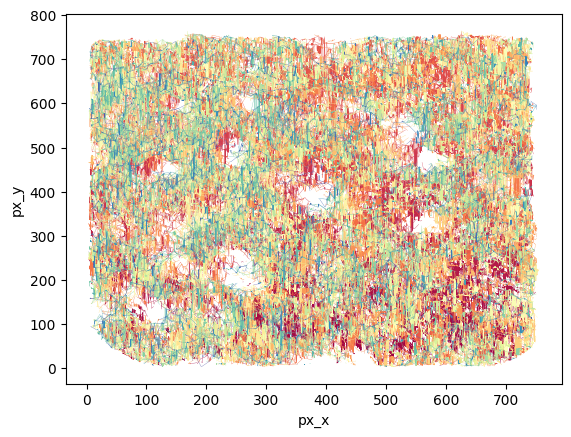

segmenting and tracking file 27/37: bar175.20k2.03_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar175.20k2.03_channel_545_patterns_masks.tif
bar175.20k2.03_channel_545_patterns_masks exists: loading data
bar175.20k2.03_channel_545_patterns_tracks exists: loading data


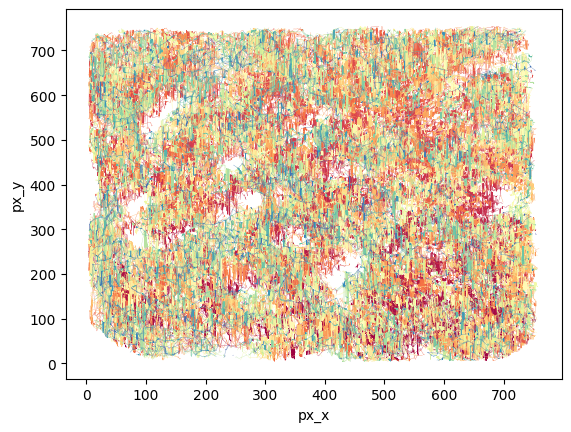

segmenting and tracking file 28/37: bar20.10k.00_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar20.10k.00_channel_545_patterns_masks.tif
bar20.10k.00_channel_545_patterns_masks exists: loading data
bar20.10k.00_channel_545_patterns_tracks exists: loading data


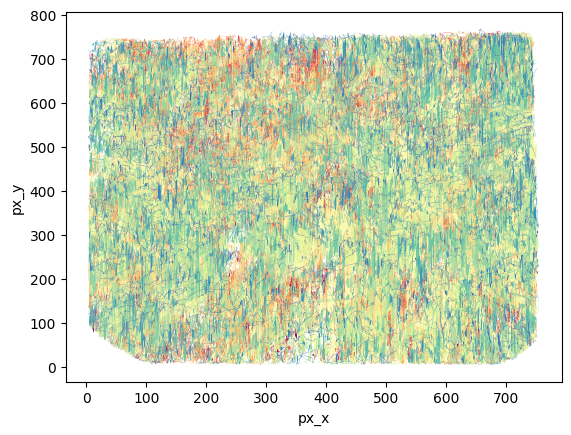

segmenting and tracking file 29/37: bar20.20k.01_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar20.20k.01_channel_545_patterns_masks.tif
bar20.20k.01_channel_545_patterns_masks exists: loading data
bar20.20k.01_channel_545_patterns_tracks exists: loading data


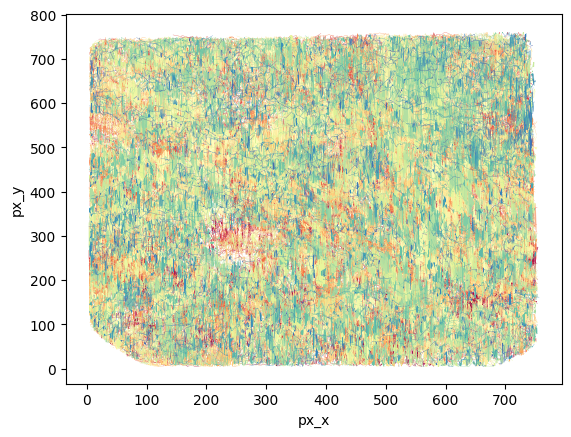

segmenting and tracking file 30/37: bar20.20K2.02_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar20.20K2.02_channel_545_patterns_masks.tif
bar20.20K2.02_channel_545_patterns_masks exists: loading data
bar20.20K2.02_channel_545_patterns_tracks exists: loading data


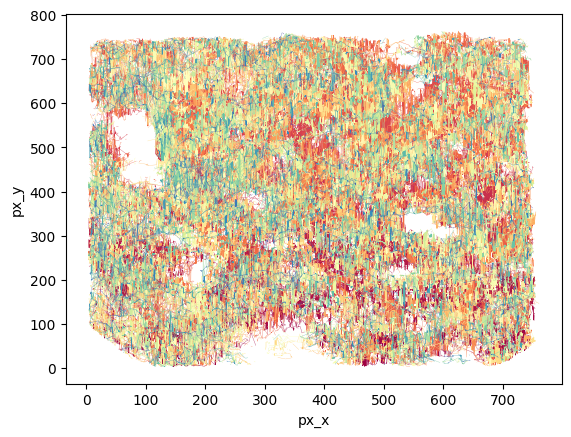

segmenting and tracking file 31/37: bar20.20k2.03_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\bar20.20k2.03_channel_545_patterns_masks.tif
bar20.20k2.03_channel_545_patterns_masks exists: loading data
bar20.20k2.03_channel_545_patterns_tracks exists: loading data


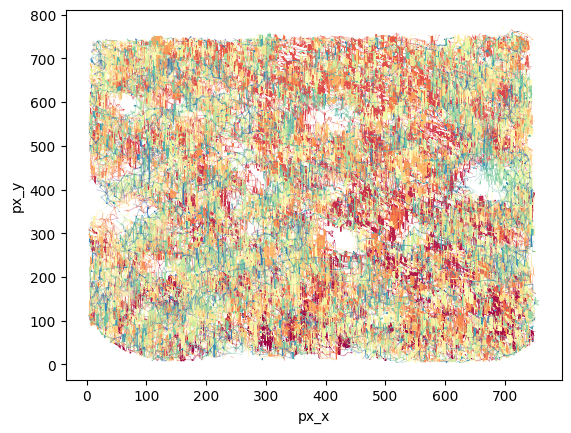

INFO:cellpose.core:** TORCH CUDA version installed and working. **
INFO:cellpose.core:>>>> using GPU (CUDA)


segmenting and tracking file 32/37: dark.10k2.02_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\dark.10k2.02_channel_545_patterns_masks.tif


INFO:cellpose.models:>>>> loading model C:\Users\Nikon\.cellpose\models\mdck_optoegfr_01
INFO:cellpose.io:reading tiff with 576 planes
100%|██████████| 576/576 [00:00<00:00, 1148.19it/s]
0it [00:00, ?it/s]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
1it [00:03,  3.88s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
2it [00:07,  3.82s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
3it [00:11,  3.78s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
4it [00:15,  3.78s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
5it [00:18,  3.77s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
6it [00:22,  3.76s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
7it [00:26,  3.77s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
8it [00:30,  3.74s/it]INFO:cellpose.transforms:processing graysca

      label   area        px_y        px_x  frame
0         1  199.0    9.683417  244.301508      0
1         2  200.0   12.690000  364.815000      0
2         3  134.0   11.343284  374.761194      0
3         4  261.0   11.854406  503.674330      0
4         5  327.0   14.470948  457.140673      0
...     ...    ...         ...         ...    ...
1929   1930  182.0  751.346154  713.148352      0
1930   1931  136.0  751.889706   96.227941      0
1931   1932  132.0  752.068182  368.590909      0
1932   1933  210.0  754.561905  666.438095      0
1933   1934  168.0  755.916667  686.678571      0

[1934 rows x 5 columns]
      label   area        px_y        px_x  frame
0      1935  133.0    8.398496  368.676692      1
1      1936  323.0   12.634675  666.349845      1
2      1937  129.0    9.798450  343.062016      1
3      1938  278.0   14.848921  355.363309      1
4      1939  257.0   13.027237  458.342412      1
...     ...    ...         ...         ...    ...
1925   3860  197.0  751.2

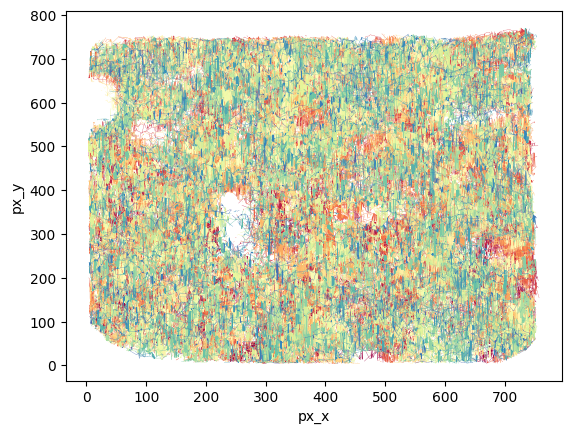

INFO:cellpose.core:** TORCH CUDA version installed and working. **
INFO:cellpose.core:>>>> using GPU (CUDA)


segmenting and tracking file 33/37: dark.10k2.03_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\dark.10k2.03_channel_545_patterns_masks.tif


INFO:cellpose.models:>>>> loading model C:\Users\Nikon\.cellpose\models\mdck_optoegfr_01
INFO:cellpose.io:reading tiff with 576 planes
100%|██████████| 576/576 [00:00<00:00, 1136.89it/s]
0it [00:00, ?it/s]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
1it [00:03,  3.59s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
2it [00:07,  3.52s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
3it [00:10,  3.52s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
4it [00:14,  3.50s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
5it [00:17,  3.50s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
6it [00:21,  3.76s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
7it [00:25,  3.66s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
8it [00:28,  3.60s/it]INFO:cellpose.transforms:processing graysca

      label   area        px_y        px_x  frame
0         1  296.0    8.104730  158.844595      0
1         2  249.0    8.939759  231.317269      0
2         3  116.0    4.956897  248.155172      0
3         4  203.0    7.157635  372.596059      0
4         5  164.0    7.109756  440.310976      0
...     ...    ...         ...         ...    ...
1576   1577  298.0  755.526846  590.228188      0
1577   1578  322.0  753.335404  720.736025      0
1578   1579  280.0  755.707143  169.453571      0
1579   1580  375.0  755.656000  569.885333      0
1580   1581   81.0  752.000000  212.567901      0

[1581 rows x 5 columns]
      label   area        px_y        px_x  frame
0      1582  283.0    7.826855  158.611307      1
1      1583  223.0    8.264574  218.067265      1
2      1584  164.0    5.560976  249.457317      1
3      1585  138.0    6.224638  463.369565      1
4      1586  131.0    6.832061  475.870229      1
...     ...    ...         ...         ...    ...
1580   3162  232.0  753.4

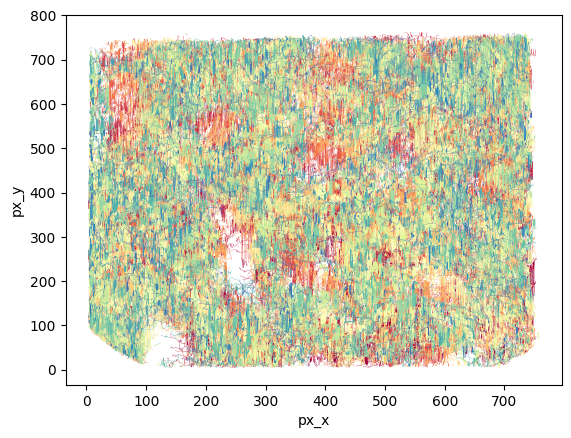

INFO:cellpose.core:** TORCH CUDA version installed and working. **
INFO:cellpose.core:>>>> using GPU (CUDA)


segmenting and tracking file 34/37: down.20k.06_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\down.20k.06_channel_545_patterns_masks.tif


INFO:cellpose.models:>>>> loading model C:\Users\Nikon\.cellpose\models\mdck_optoegfr_01
INFO:cellpose.io:reading tiff with 813 planes
100%|██████████| 813/813 [00:01<00:00, 731.10it/s]
0it [00:00, ?it/s]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
1it [00:03,  3.91s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
2it [00:07,  3.85s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
3it [00:11,  3.80s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
4it [00:15,  3.77s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
5it [00:18,  3.75s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
6it [00:23,  4.05s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
7it [00:27,  3.97s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
8it [00:31,  3.93s/it]INFO:cellpose.transforms:processing grayscal

      label   area        px_y        px_x  frame
0         1  163.0    6.411043  417.846626      0
1         2  245.0   11.261224  621.424490      0
2         3  269.0    8.739777  635.672862      0
3         4  166.0    8.855422  363.566265      0
4         5  148.0    9.304054  312.432432      0
...     ...    ...         ...         ...    ...
1931   1932  284.0  749.035211  723.816901      0
1932   1933   91.0  745.736264  398.813187      0
1933   1934  354.0  749.757062  600.909605      0
1934   1935  183.0  752.005464  505.814208      0
1935   1936  166.0  751.656627  385.427711      0

[1936 rows x 5 columns]
      label   area        px_y        px_x  frame
0      1937  221.0    6.343891  638.610860      1
1      1938  182.0    9.170330  624.659341      1
2      1939  232.0   11.987069  355.909483      1
3      1940  129.0   10.542636  410.403101      1
4      1941   78.0    8.166667  419.525641      1
...     ...    ...         ...         ...    ...
1894   3831  122.0  746.5

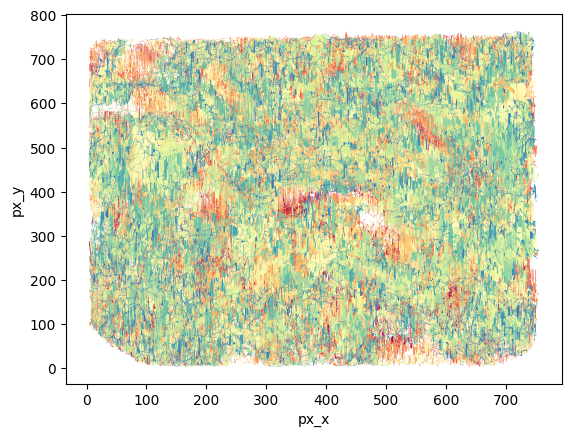

INFO:cellpose.core:** TORCH CUDA version installed and working. **
INFO:cellpose.core:>>>> using GPU (CUDA)


segmenting and tracking file 35/37: down.20k.07_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\down.20k.07_channel_545_patterns_masks.tif


INFO:cellpose.models:>>>> loading model C:\Users\Nikon\.cellpose\models\mdck_optoegfr_01
INFO:cellpose.io:reading tiff with 813 planes
100%|██████████| 813/813 [00:01<00:00, 706.39it/s]
0it [00:00, ?it/s]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
1it [00:03,  3.71s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
2it [00:07,  3.71s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
3it [00:11,  3.66s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
4it [00:14,  3.66s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
5it [00:18,  3.69s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
6it [00:22,  3.73s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
7it [00:25,  3.71s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
8it [00:29,  3.69s/it]INFO:cellpose.transforms:processing grayscal

      label   area        px_y        px_x  frame
0         1  190.0    5.747368  452.142105      0
1         2  302.0   10.225166  180.248344      0
2         3  186.0    7.688172  196.935484      0
3         4  193.0    6.658031  435.746114      0
4         5  369.0   10.457995  496.027100      0
...     ...    ...         ...         ...    ...
1699   1700  135.0  750.237037  459.355556      0
1700   1701  118.0  750.669492  446.745763      0
1701   1702  279.0  757.888889  683.946237      0
1702   1703  142.0  755.366197  475.774648      0
1703   1704  138.0  756.811594  700.855072      0

[1704 rows x 5 columns]
      label   area        px_y        px_x  frame
0      1705  305.0    9.137705  183.809836      1
1      1706  170.0    7.417647  200.005882      1
2      1707  138.0    5.500000  452.260870      1
3      1708  171.0    7.128655  561.549708      1
4      1709  180.0    8.672222  575.572222      1
...     ...    ...         ...         ...    ...
1687   3392  118.0  746.3

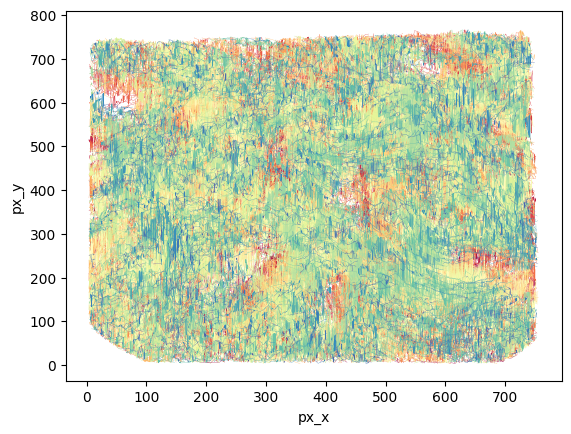

INFO:cellpose.core:** TORCH CUDA version installed and working. **
INFO:cellpose.core:>>>> using GPU (CUDA)


segmenting and tracking file 36/37: down.20k.08_channel_545_patterns
D:\Harrison\cells\mdck_analysis\barspeeds\masks\down.20k.08_channel_545_patterns_masks.tif


INFO:cellpose.models:>>>> loading model C:\Users\Nikon\.cellpose\models\mdck_optoegfr_01
INFO:cellpose.io:reading tiff with 813 planes
100%|██████████| 813/813 [00:01<00:00, 716.32it/s]
0it [00:00, ?it/s]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
1it [00:03,  3.95s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
2it [00:07,  3.88s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
3it [00:12,  4.17s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
4it [00:15,  3.97s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
5it [00:19,  3.88s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
6it [00:23,  3.81s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
7it [00:27,  3.79s/it]INFO:cellpose.transforms:processing grayscale image with (1600, 800) HW
8it [00:30,  3.78s/it]INFO:cellpose.transforms:processing grayscal

      label   area        px_y        px_x  frame
0         1  120.0    5.033333  115.966667      0
1         2  295.0    8.755932  133.762712      0
2         3  247.0    9.226721  476.587045      0
3         4  154.0    7.487013  578.655844      0
4         5  104.0    5.653846  589.798077      0
...     ...    ...         ...         ...    ...
1827   1828  173.0  751.774566  523.554913      0
1828   1829  152.0  755.236842  575.809211      0
1829   1830  112.0  753.598214  727.196429      0
1830   1831   90.0  756.755556  610.588889      0
1831   1832  138.0  763.746377  653.478261      0

[1832 rows x 5 columns]
      label   area        px_y        px_x  frame
0      1833  318.0    9.144654  136.327044      1
1      1834  280.0   10.096429  477.153571      1
2      1835  172.0    7.808140  581.389535      1
3      1836  155.0    6.864516  594.122581      1
4      1837   86.0    5.813953  492.616279      1
...     ...    ...         ...         ...    ...
1839   3672  134.0  750.7

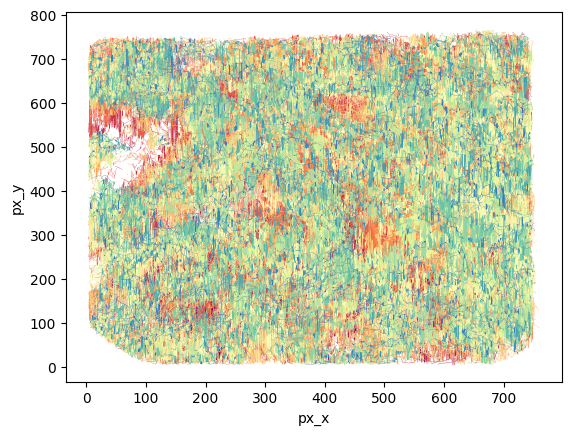

In [8]:

in_dir = Path(args.dir)

masks_dir = in_dir / "masks"
tracks_dir = in_dir / "tracks"

masks_dir.mkdir(exist_ok=True)
tracks_dir.mkdir(exist_ok=True)

files = list(in_dir.glob(args.glob))

for i, file in enumerate(files):
    print(f"segmenting and tracking file {i}/{len(files)}: {file.stem}")
    tracks = process_file(file, in_dir, args)

    import seaborn as sns

    sns.lineplot(tracks, x="px_x", y="px_y", hue="track_id", palette="Spectral", errorbar=None, lw=0.2, legend=False)
    plt.show()

